# Preprocessing Images for OCR

## Covered in this ipynb

1. Gray Scalling
2. Binarization
3. Noise Removal
4. Dilation and Erosion
5. Rotation / Deskewing


In [1]:
import cv2
import numpy as np
from matplotlib import pyplot as plt


## 00: Opening an Image

In [2]:
image_file = "../data/raw_data/Prescriptions/0734--8979662--20230705_page_2.jpg"
#image_file = "../data/temp/0708--8787562--20230705_page_0.jpg"

img = cv2.imread(image_file)


In [3]:
def display(im_path):
    dpi = 80
    im_data = plt.imread(im_path)

    height, width  = im_data.shape[:2]
    
    # What size does the figure need to be in inches to fit the image?
    figsize = width / float(dpi), height / float(dpi)

    # Create a figure of the right size with one axes that takes up the full figure
    fig = plt.figure(figsize=figsize)
    ax = fig.add_axes([0, 0, 1, 1])

    # Hide spines, ticks, etc.
    ax.axis('off')

    # Display the image.
    ax.imshow(im_data, cmap='gray')

    plt.show()

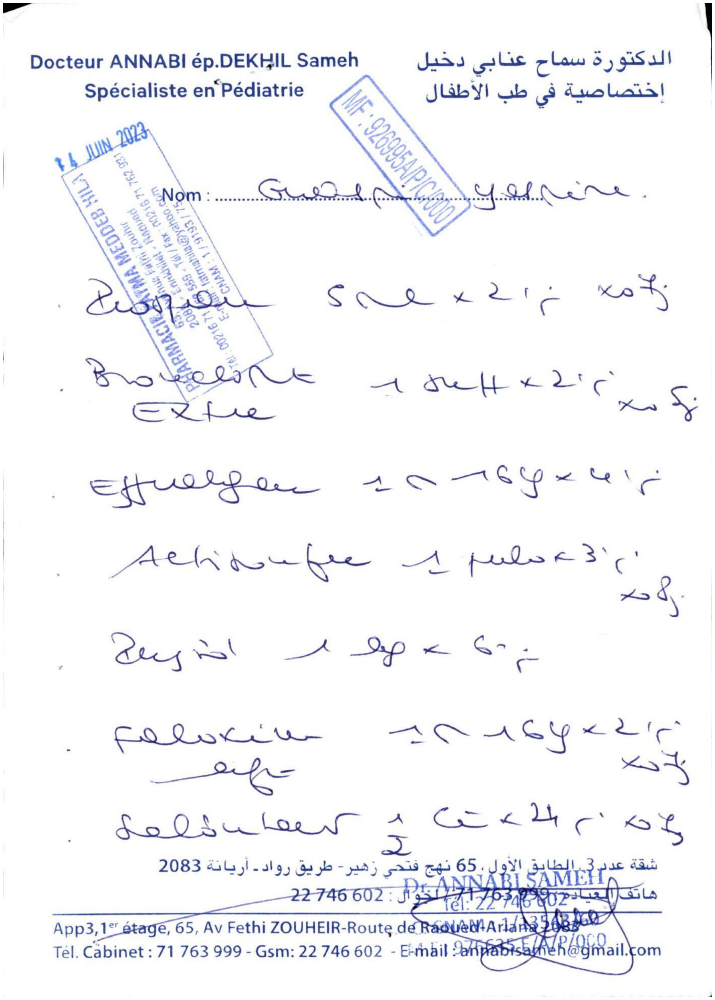

In [4]:
display(image_file)

## 01: Gray Scalling Images

In [5]:
def grayscale(image):
    return cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)


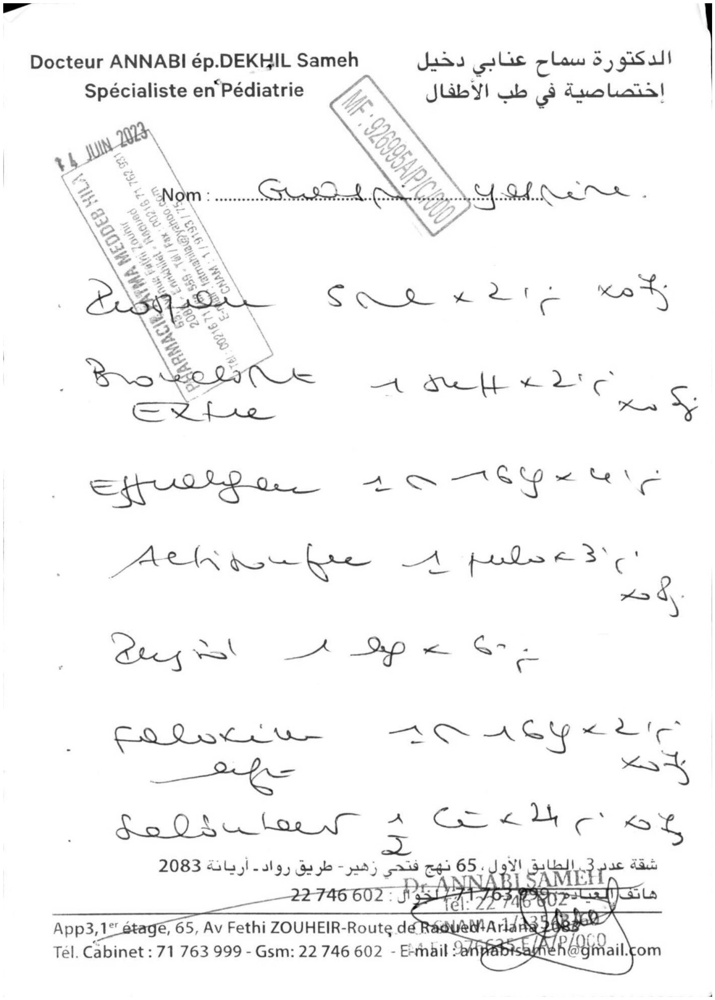

In [6]:
gray_image = grayscale(img)
cv2.imwrite("../data/temp/gray.jpg", gray_image)
display("../data/temp/gray.jpg")

## 02: Binarization

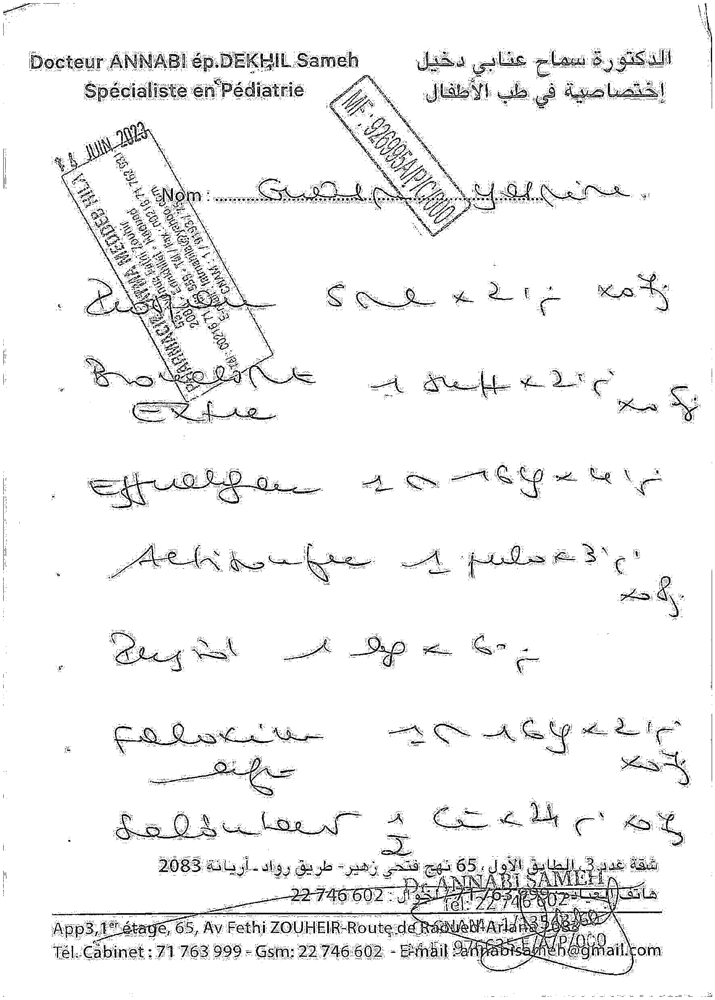

In [7]:
im_bw = cv2.adaptiveThreshold(gray_image, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, 
                                                cv2.THRESH_BINARY, 3, 2)
cv2.imwrite("../data/temp/bw_image.jpg", im_bw)
display("../data/temp/bw_image.jpg")

## 03: Noise Removal

In [8]:
def noise_removal(image):
    kernel = np.ones((1, 1), np.uint8)
    image = cv2.dilate(image, kernel, iterations=1)
    kernel = np.ones((1, 1), np.uint8)
    image = cv2.erode(image, kernel, iterations=1)
    image = cv2.morphologyEx(image, cv2.MORPH_CLOSE, kernel)
    image = cv2.medianBlur(image, 3)
    return (image)

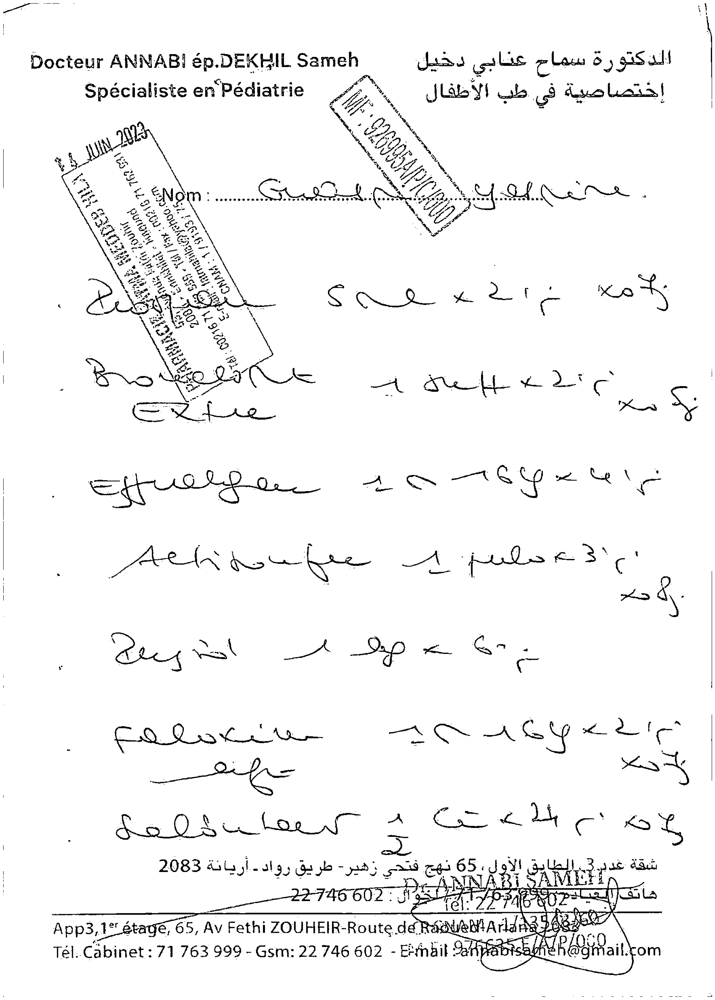

In [9]:
no_noise = noise_removal(im_bw)
cv2.imwrite("../data/temp/no_noise.jpg", no_noise)
display("../data/temp/no_noise.jpg")

## 04: Dilation and Erosion

In [10]:
def thin_font(image):
    image = cv2.bitwise_not(image)
    kernel = np.ones((2,2),np.uint8)
    image = cv2.erode(image, kernel, iterations=1)
    image = cv2.bitwise_not(image)
    return (image)

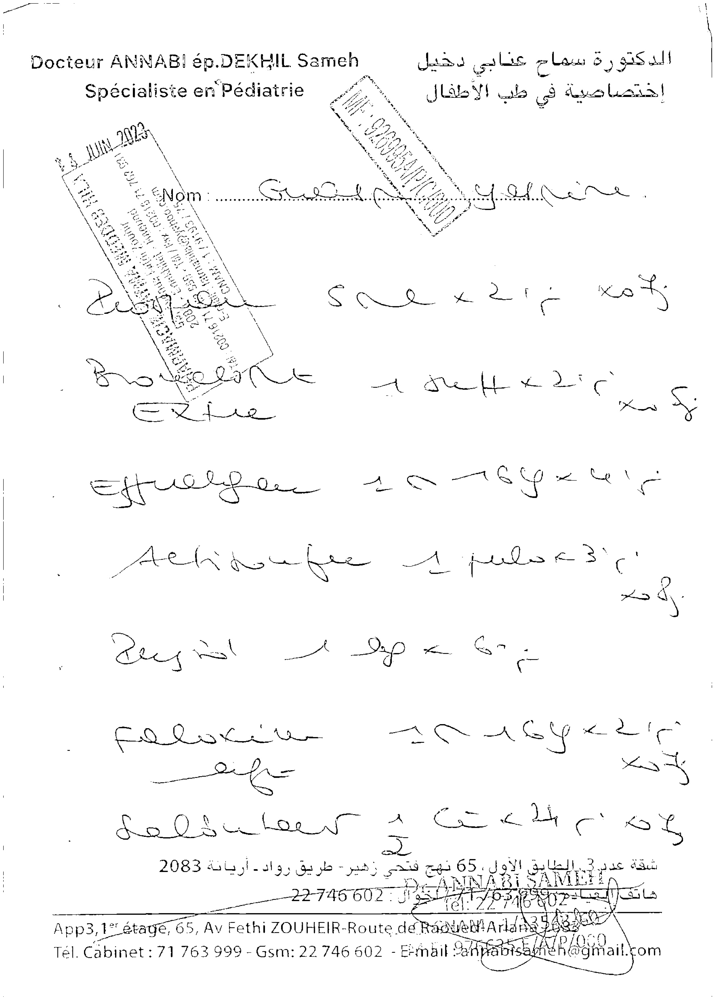

In [11]:
eroded_image = thin_font(no_noise)
cv2.imwrite("../data/temp/eroded_image.jpg", eroded_image)
display("../data/temp/eroded_image.jpg")

In [12]:
def thick_font(image):
    image = cv2.bitwise_not(image)
    kernel = np.ones((2,2),np.uint8)
    image = cv2.dilate(image, kernel, iterations=1)
    image = cv2.bitwise_not(image)
    return (image)

In [13]:
dilated_image = thick_font(no_noise)
cv2.imwrite("../data/temp/dilated_image.jpg", dilated_image)

True

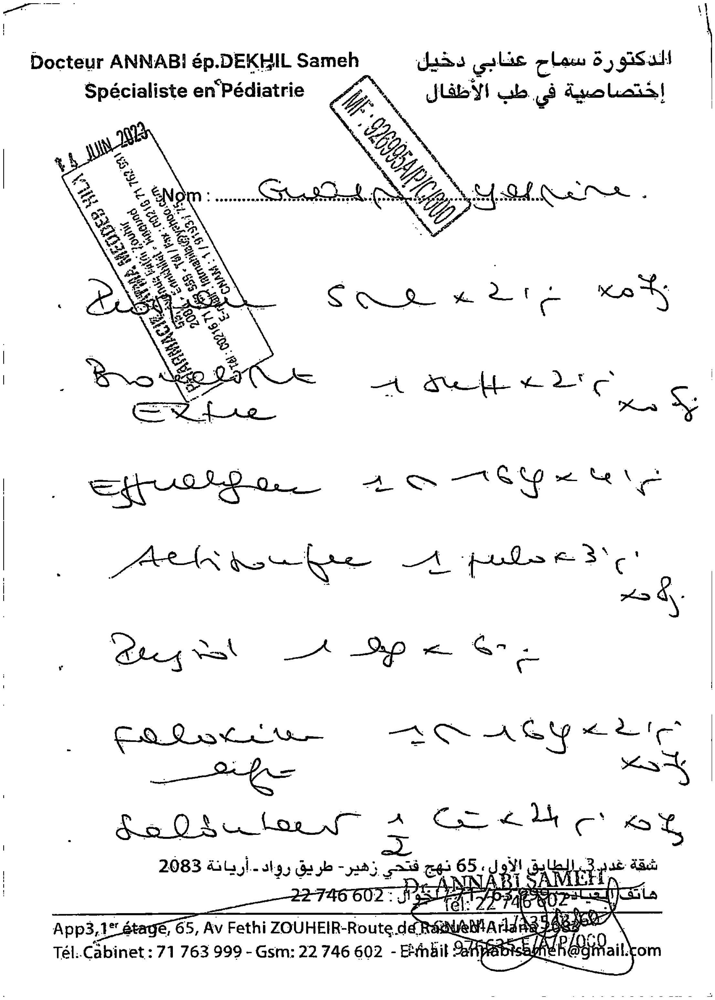

In [14]:
display("../data/temp/dilated_image.jpg")

## 05: Rotation / Deskewing

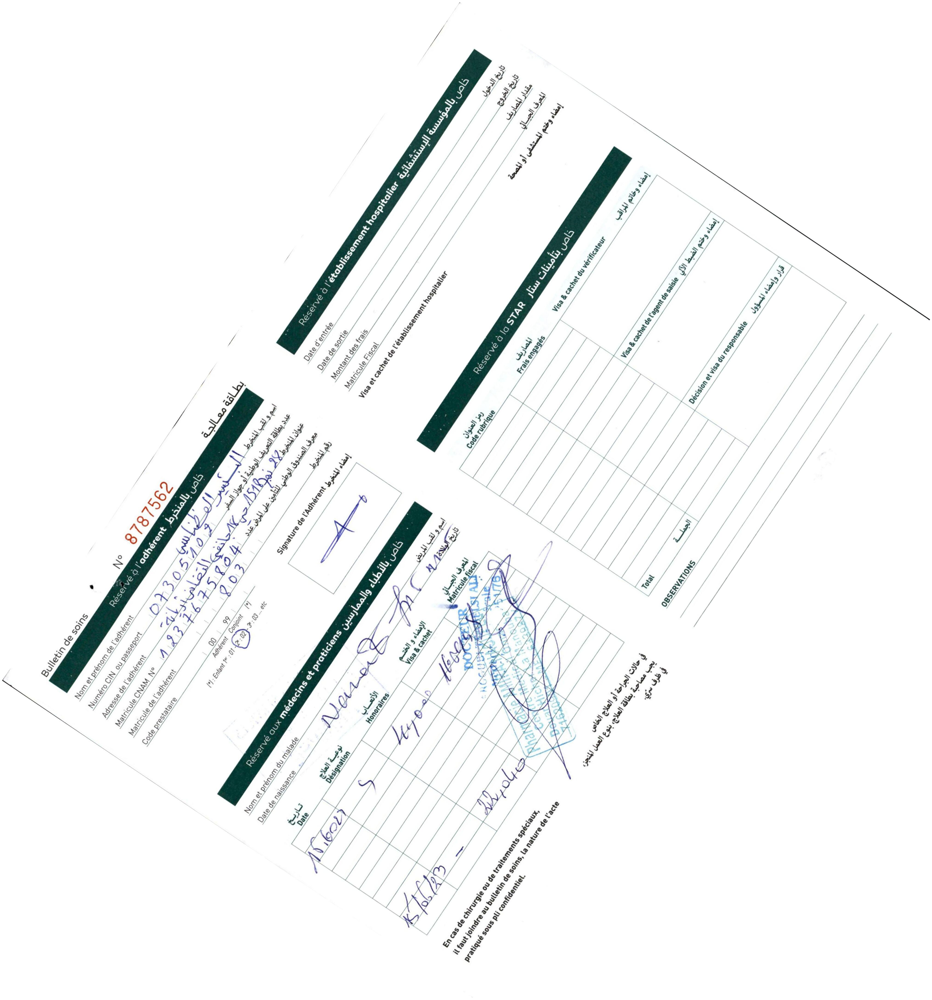

In [15]:
new = cv2.imread("../data/temp/0708--8787562--20230705_page_03.jpg")
display("../data/temp/0708--8787562--20230705_page_03.jpg")

In [16]:
def check_image_rotation(cvImage):
    gray = cv2.cvtColor(cvImage, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    # Edge detection using Canny
    edges = cv2.Canny(blurred, 50, 150, apertureSize=3)
    # Detect lines using Hough Line Transform
    lines = cv2.HoughLines(edges, 1, np.pi / 180, 200) 
    if lines is None:
        return "upright"  # No lines detected, assume it's upright
    
    # Analyze the angle of the lines
    angles = []
    for line in lines:
        rho, theta = line[0]
        angle = np.degrees(theta) - 90  # Convert from radians to degrees and normalize the angle
        angles.append(angle)

    # Calculate the median of the angles
    median_angle = np.median(angles)
    # Determine rotation direction based on median angle
    if median_angle < -10:
        return "left"  # Rotated to the right
    elif median_angle > 10:
        return "right"   # Rotated to the left
    else:
        return "upright"  # No significant rotation detected


In [17]:
def prepare_image(cvImage):
    gray = cv2.cvtColor(cvImage, cv2.COLOR_BGR2GRAY)
    # Apply adaptive thresholding to get a "white" background
    thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                   cv2.THRESH_BINARY, 11, 2)
    # Sharpen the text using a kernel
    kernel = np.array([[0, -1, 0], 
                       [-1, 5,-1], 
                       [0, -1, 0]])

    sharpened = cv2.filter2D(thresh, -1, kernel)
    return sharpened

In [18]:
def getSkewAngle(cvImage) -> float:
    # Prep image, copy, convert to gray scale, blur, and threshold
    prepared_image=prepare_image(cvImage)

    newImage = prepared_image.copy()
    #gray = cv2.cvtColor(newImage, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(newImage, (9, 9), 0)
    thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
    # Apply dilate to merge text into meaningful lines/paragraphs.
    # Use larger kernel on X axis to merge characters into single line, cancelling out any spaces.
    # But use smaller kernel on Y axis to separate between different blocks of text
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (30, 5))
    dilate = cv2.dilate(thresh, kernel, iterations=2)    
    # Find all external contours only (not internal contours)
    contours, hierarchy = cv2.findContours(dilate, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
    contours = sorted(contours, key=cv2.contourArea, reverse=True)

    # Draw bounding rectangles for each contour (for debugging and visualization)
    for c in contours:
        rect = cv2.boundingRect(c)
        x, y, w, h = rect
        cv2.rectangle(newImage, (x, y), (x + w, y + h), (0, 255, 0), 2)

    # Find the largest external contour and surround it with a minimum area box
    largestContour = contours[0]
    #print(len(contours))  # For debugging: prints the number of contours found
    minAreaRect = cv2.minAreaRect(largestContour)
    #cv2.imwrite("../data/temp/boxes.jpg", newImage)  # Save the image with bounding boxes for verification

    # Determine the angle of rotation (skew) and adjust it if necessary
    angle = minAreaRect[-1]
    #print("first angle detected",angle )
    rotation_side = check_image_rotation(cvImage)
    if rotation_side == "left":
         angle = angle -90
    elif rotation_side == "upright":
        return 0

    return -1.0 * angle  # Negate because we need to deskew


In [19]:
# Rotate the image around its center
def rotateImage(cvImage, angle: float):
    newImage = cvImage.copy()
    (h, w) = newImage.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    newImage = cv2.warpAffine(newImage, M, (w, h), flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_REPLICATE)
    return newImage


In [20]:
# Deskew image
def deskew(cvImage):
    angle = getSkewAngle(cvImage)
    print (angle)
    if angle<10 and angle> -10 or angle == 90 or angle == -90 :
        return cvImage
    print("angle in rotation is", angle)

    return rotateImage(cvImage, -1.0 * angle)


In [21]:
# def getSkewAngle(cvImage) -> float:
#     newImage = cvImage.copy()
    
#     gray = cv2.cvtColor(newImage, cv2.COLOR_BGR2GRAY)
#     thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]

#     # Find all contours from the thresholded image (not dilated)
#     contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
#     contours = sorted(contours, key=cv2.contourArea, reverse=False)

#     # Draw bounding boxes for each letter
#     for c in contours:
#         x, y, w, h = cv2.boundingRect(c)
        
#         # Filter out very small contours (noise)
#         if w > 5 and h > 10:  
#             cv2.rectangle(newImage, (x, y), (x + w, y + h), (0, 255, 0), 2)
#     # Find the largest external contour and surround it with a minimum area box
#     largestContour = contours[0]
#     print(len(contours))  # For debugging: prints the number of contours found
#     minAreaRect = cv2.minAreaRect(largestContour)
#     cv2.imwrite("../data/temp/boxes.jpg", newImage)  # Save the image with bounding boxes for verification

#     # Determine the angle of rotation (skew) and adjust it if necessary
#     angle = minAreaRect[-1]
#     print ("minAreaRect is " , minAreaRect)
#     print("first angle detected",angle )
#     # Normalize the rotation angle
#     if angle > 90 :
#         angle = angle +90
#     return -1.0 * angle  # Negate because we need to deskew


# def rotateImage(cvImage, angle: float):
#     (h, w) = cvImage.shape[:2]
#     center = (w // 2, h // 2)

#     # Compute the rotation matrix
#     M = cv2.getRotationMatrix2D(center, angle, 1.0)

#     # Compute the new bounding dimensions of the rotated image
#     cos = np.abs(M[0, 0])
#     sin = np.abs(M[0, 1])
#     new_w = int((h * sin) + (w * cos))
#     new_h = int((h * cos) + (w * sin))

#     # Adjust the rotation matrix to take into account translation
#     M[0, 2] += (new_w / 2) - center[0]
#     M[1, 2] += (new_h / 2) - center[1]

#     # Perform the actual rotation and return the image
#     rotated = cv2.warpAffine(cvImage, M, (new_w, new_h), flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_REPLICATE)
#     return rotated


# # Deskew image
# def deskew(cvImage):
#     angle = getSkewAngle(cvImage)
#     print (angle)
#     if angle<10 and angle> -10  :
#         return cvImage
#     print("angle in rotation is", angle)

#     return rotateImage(cvImage, -1.0 * angle)


In [22]:
fixed = deskew(new)
cv2.imwrite("../data/temp/rotated_fixed.jpg", fixed)

56.82148742675781
angle in rotation is 56.82148742675781


True

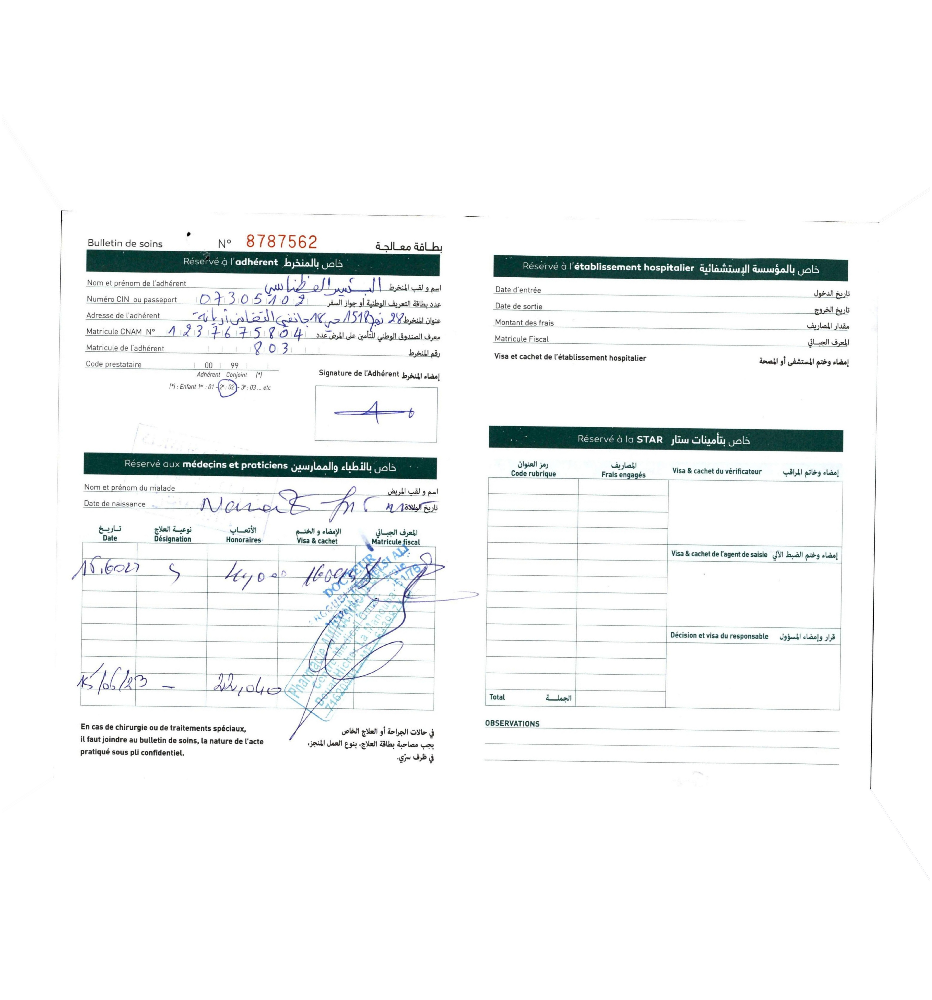

In [23]:
display("../data/temp/rotated_fixed.jpg")